In [1]:
import ee
import geemap
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

ee.Authenticate()

ee.Initialize(project='general-porpose')

geometry = ee.Geometry.Polygon(
    [[[-56.19933935093308, -15.570030087161426],
      [-56.236418208354955, -15.63616420965171],
      [-56.173246821636205, -15.75515175246836],
      [-56.110075434917455, -15.760438474073672],
      [-56.079863032573705, -15.701615952093842],
      [-56.002958735698705, -15.706243058621192],
      [-55.91712804722214, -15.675173328966476],
      [-55.92468114780808, -15.622277812891932],
      [-55.98510595249558, -15.587888400489534],
      [-56.00982519077683, -15.527031492578372],
      [-56.052397212261205, -15.503213026342152],
      [-56.09290929722214, -15.518430696875168],
      [-56.13616796421433, -15.537616594867629]]])



Successfully saved authorization token.


In [ ]:
indice_desejado = 'NDVI'  # Escolha entre 'EVI', 'NDVI', 'NDBI' ou 'UI'

bandas = {
    'LANDSAT_8': {'NIR': 'SR_B5', 'RED': 'SR_B4', 'BLUE': 'SR_B2', 'SWIR': 'SR_B6'},
    'LANDSAT_9': {'NIR': 'SR_B5', 'RED': 'SR_B4', 'BLUE': 'SR_B2', 'SWIR': 'SR_B6'},
    'default':   {'NIR': 'SR_B5', 'RED': 'SR_B4', 'BLUE': 'SR_B2', 'SWIR': 'SR_B6'},
}

bandas = {
    'LANDSAT_8': {'NIR': 'B5', 'RED': 'B4', 'BLUE': 'B2', 'SWIR': 'B6'},
    'LANDSAT_9': {'NIR': 'B5', 'RED': 'B4', 'BLUE': 'B2', 'SWIR': 'B6'},
    'default':   {'NIR': 'B5', 'RED': 'B4', 'BLUE': 'B2', 'SWIR': 'B6'},
}



def get_band(bands_dict, band_name, sensor):
    return bands_dict.get(sensor, bands_dict['default'])[band_name]

def calcular_indice(imagem, sensor, indice):
    nir = imagem.select(get_band(bandas, 'NIR', sensor))
    red = imagem.select(get_band(bandas, 'RED', sensor))
    blue = imagem.select(get_band(bandas, 'BLUE', sensor))
    swir = imagem.select(get_band(bandas, 'SWIR', sensor))

    if indice == 'EVI':
        return imagem.expression(
            '2.5 * ((NIR - RED) / (NIR + 6 * RED - 7.5 * BLUE + 1))',
            {'NIR': nir, 'RED': red, 'BLUE': blue}
        ).rename('EVI')

    elif indice == 'NDVI':
        return imagem.normalizedDifference([get_band(bandas, 'NIR', sensor),
                                            get_band(bandas, 'RED', sensor)]).rename('NDVI')

    elif indice == 'NDBI':
        return imagem.normalizedDifference([get_band(bandas, 'SWIR', sensor),
                                            get_band(bandas, 'NIR', sensor)]).rename('NDBI')

    elif indice == 'UI':
        ndvi = imagem.normalizedDifference([get_band(bandas, 'NIR', sensor),
                                            get_band(bandas, 'RED', sensor)])
        ndbi = imagem.normalizedDifference([get_band(bandas, 'SWIR', sensor),
                                            get_band(bandas, 'NIR', sensor)])
        return ndbi.subtract(ndvi).rename('UI')

    else:
        raise ValueError(f"Índice desconhecido: {indice}")

def mask_clouds(image):
    qa = image.select('QA_PIXEL')
    cloud_bit = 1 << 3
    shadow_bit = 1 << 4
    mask = qa.bitwiseAnd(cloud_bit).eq(0).And(qa.bitwiseAnd(shadow_bit).eq(0))
    return image.updateMask(mask)

colecao_merged = ee.ImageCollection("LANDSAT/LC08/C02/T1_L2")  # pode incluir merge com LC09 se quiser

imagens_processadas = []

for ano in range(2013, 2025):
    try:
        inicio = f"{ano}-01-01"
        fim = f"{ano}-12-31"
        colecao = colecao_merged \
            .filterBounds(geometry) \
            .filterDate(inicio, fim) \
            .filter(ee.Filter.lt('CLOUD_COVER', 30)) \
            .map(mask_clouds)

        imagem = colecao.sort('CLOUD_COVER').first()

        if imagem is None or imagem.getInfo() is None:
            continue

        sensor = ee.String(imagem.get('SPACECRAFT_ID')).getInfo()
        indice_1 = calcular_indice(imagem, sensor, 'NDVI')
        indice_2 = calcular_indice(imagem, sensor, 'NDBI')
        indice_3 = calcular_indice(imagem, sensor, 'EVI')
        indice_4 = calcular_indice(imagem, sensor, 'UI')
        imagem = imagem.addBands(indice_1)
        imagem = imagem.addBands(indice_2)
        imagem = imagem.addBands(indice_3)
        imagem = imagem.addBands(indice_4)

        # indice_array = geemap.ee_to_numpy(indice, region=geometry, scale=15)

        imagens_processadas.append({
            'ano': ano,
            'data': imagem.date().format("YYYY-MM-dd").getInfo(),
            'image_id': imagem.get('system:id').getInfo(),
            'cloud_percent': imagem.get('CLOUD_COVER').getInfo(),
            # f'{indice_desejado.lower()}_array': indice_array,
            'imagem_raw': imagem
        })

        print(f'Extraído {indice_desejado} para {imagem.date().format("YYYY-MM-dd").getInfo()} '
              f'cobertura {imagem.get("CLOUD_COVER").getInfo()}')

    except Exception as e:
        print(f"Erro Landsat {ano}: {e}")


Extraído NDVI para 2013-07-16 cobertura 0
Extraído NDVI para 2014-07-03 cobertura 0
Extraído NDVI para 2015-08-07 cobertura 0
Extraído NDVI para 2016-05-05 cobertura 0
Extraído NDVI para 2017-07-11 cobertura 0
Extraído NDVI para 2018-05-27 cobertura 0
Extraído NDVI para 2019-07-01 cobertura 0.21
Extraído NDVI para 2020-08-04 cobertura 0
Extraído NDVI para 2021-06-04 cobertura 0
Extraído NDVI para 2022-05-06 cobertura 0
Extraído NDVI para 2023-06-10 cobertura 0
Extraído NDVI para 2024-07-14 cobertura 0


In [51]:
bandas_rgb = ['SR_B4', 'SR_B3', 'SR_B2']  # RGB para Landsat SR
def plotar_rgb(resultados, bands, scale=30, ncols=3):
    n = len(resultados)
    nrows = (n + ncols - 1) // ncols
    fig, axes = plt.subplots(nrows, ncols, figsize=(5*ncols, 5*nrows))
    axes = axes.flatten()

    for i, r in enumerate(resultados):
        ax = axes[i]
        try:
            imagem = r['imagem_raw']
            rgb = geemap.ee_to_numpy(imagem.select(bands), region=geometry, scale=scale)

            print(f"[{r['data']}] shape: {rgb.shape}")

            if rgb.shape[-1] != 3:
                raise ValueError(f"Esperado 3 bandas RGB, mas recebi shape {rgb.shape}")

            # Normaliza reflectância e limpa NaNs
            rgb = np.nan_to_num(rgb / 10000.0)
            rgb = np.clip(rgb, 0, 1)

            # Aplica realce automático baseado nos quantis
            p2, p98 = np.percentile(rgb[rgb > 0], (5, 95))
            rgb = np.clip((rgb - p2) / (p98 - p2), 0, 1)

            if np.isnan(rgb).all() or np.max(rgb) == 0:
                ax.text(0.5, 0.5, "Imagem vazia", ha='center', va='center')
            else:
                print(f"min: {rgb.min():.2f}, max: {rgb.max():.2f}")
                ax.imshow(rgb, vmin=0, vmax=1)

            ax.set_title(f"RGB - {r['data']}", fontsize=10)
            ax.axis('off')

        except Exception as e:
            print(f"Erro ao processar imagem {i}: {e}")
            ax.text(0.5, 0.5, "Erro", ha='center', va='center')
            ax.axis('off')

    for j in range(i+1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()


[2013-07-16] shape: (949, 1141, 3)
min: 0.00, max: 1.00
[2014-07-03] shape: (949, 1141, 3)
min: 0.00, max: 1.00
[2015-08-07] shape: (949, 1141, 3)
min: 0.00, max: 1.00
[2016-05-05] shape: (949, 1141, 3)
min: 0.00, max: 1.00
[2017-07-11] shape: (949, 1141, 3)
min: 0.00, max: 1.00
[2018-05-27] shape: (949, 1141, 3)
min: 0.00, max: 1.00
[2019-07-01] shape: (949, 1141, 3)
min: 0.00, max: 1.00
[2020-08-04] shape: (949, 1141, 3)
min: 0.00, max: 1.00
[2021-06-04] shape: (949, 1141, 3)
min: 0.00, max: 1.00
[2022-05-06] shape: (949, 1141, 3)
min: 0.00, max: 1.00
[2023-06-10] shape: (949, 1141, 3)
min: 0.00, max: 1.00
[2024-07-14] shape: (949, 1141, 3)
min: 0.00, max: 1.00


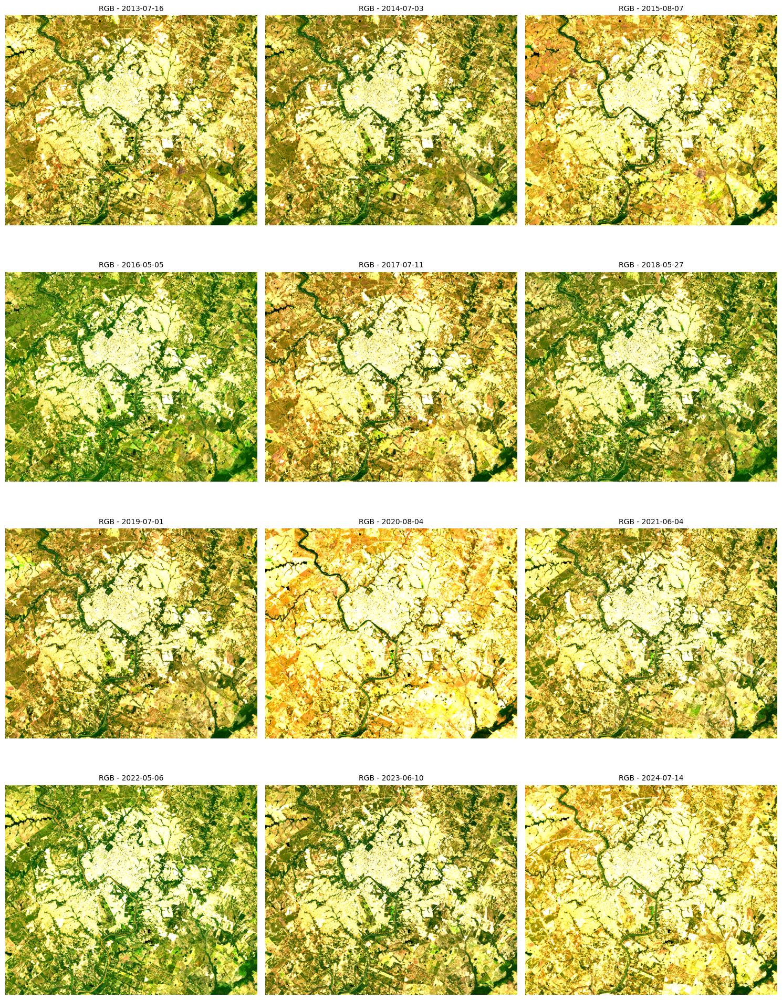

In [52]:
plotar_rgb(imagens_processadas,bandas_rgb)

[2013-07-16] shape: (949, 1141, 3)
min: 0.00, max: 1.00
[2014-07-03] shape: (949, 1141, 3)
min: 0.00, max: 1.00
[2015-08-07] shape: (949, 1141, 3)
min: 0.00, max: 1.00
[2016-05-05] shape: (949, 1141, 3)
min: 0.00, max: 1.00
[2017-07-11] shape: (949, 1141, 3)
min: 0.00, max: 1.00


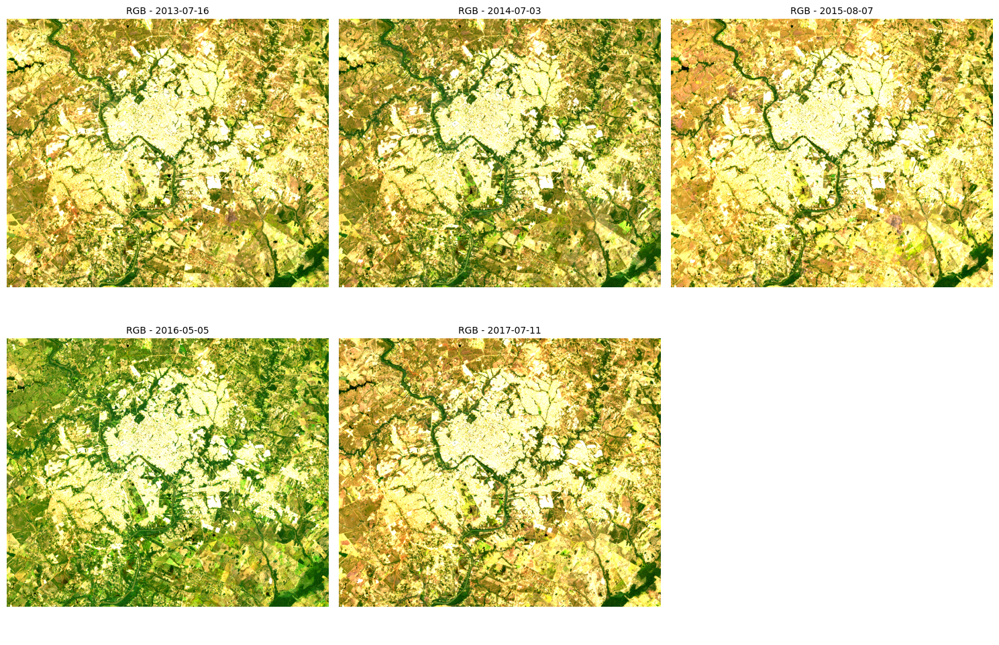

In [18]:
plotar_rgb(imagens_processadas[:5],bandas_rgb)

In [21]:
def plotar_ndvi(resultados, scale=30, ncols=3, banda='NDVI'):
    """
    Exibe as imagens NDVI das imagens armazenadas em 'resultados'.

    Parâmetros:
    - resultados: lista de dicionários com a chave 'imagem_raw' (ee.Image)
    - scale: resolução espacial (em metros)
    - ncols: número de colunas no grid
    - banda: nome da banda NDVI (ou outro índice derivado)
    """
    n = len(resultados)
    nrows = (n + ncols - 1) // ncols
    fig, axes = plt.subplots(nrows, ncols, figsize=(5*ncols, 5*nrows))
    axes = axes.flatten()

    for i, r in enumerate(resultados):
        ax = axes[i]
        try:
            imagem = r['imagem_raw']
            ndvi_img = imagem.select(banda)
            ndvi_array = geemap.ee_to_numpy(ndvi_img, region=geometry, scale=scale).squeeze()

            print(f"[{r['data']}] NDVI shape: {ndvi_array.shape}")

            if np.isnan(ndvi_array).all():
                ax.text(0.5, 0.5, "NDVI vazio", ha='center', va='center')
            else:
                # Corta valores extremos se necessário
                ndvi_array = np.clip(ndvi_array, -1, 1)
                ax.imshow(ndvi_array, cmap="RdYlGn", vmin=-1, vmax=1)
                ax.set_title(f"NDVI - {r['data']}", fontsize=10)

            ax.axis('off')

        except Exception as e:
            print(f"Erro NDVI {i}: {e}")
            ax.text(0.5, 0.5, "Erro", ha='center', va='center')
            ax.axis('off')

    for j in range(i+1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()


[2013-07-16] NDVI shape: (949, 1141)
[2014-07-03] NDVI shape: (949, 1141)
[2015-08-07] NDVI shape: (949, 1141)
[2016-05-05] NDVI shape: (949, 1141)
[2017-07-11] NDVI shape: (949, 1141)
[2018-05-27] NDVI shape: (949, 1141)
[2019-07-01] NDVI shape: (949, 1141)
[2020-08-04] NDVI shape: (949, 1141)
[2021-06-04] NDVI shape: (949, 1141)
[2022-05-06] NDVI shape: (949, 1141)
[2023-06-10] NDVI shape: (949, 1141)


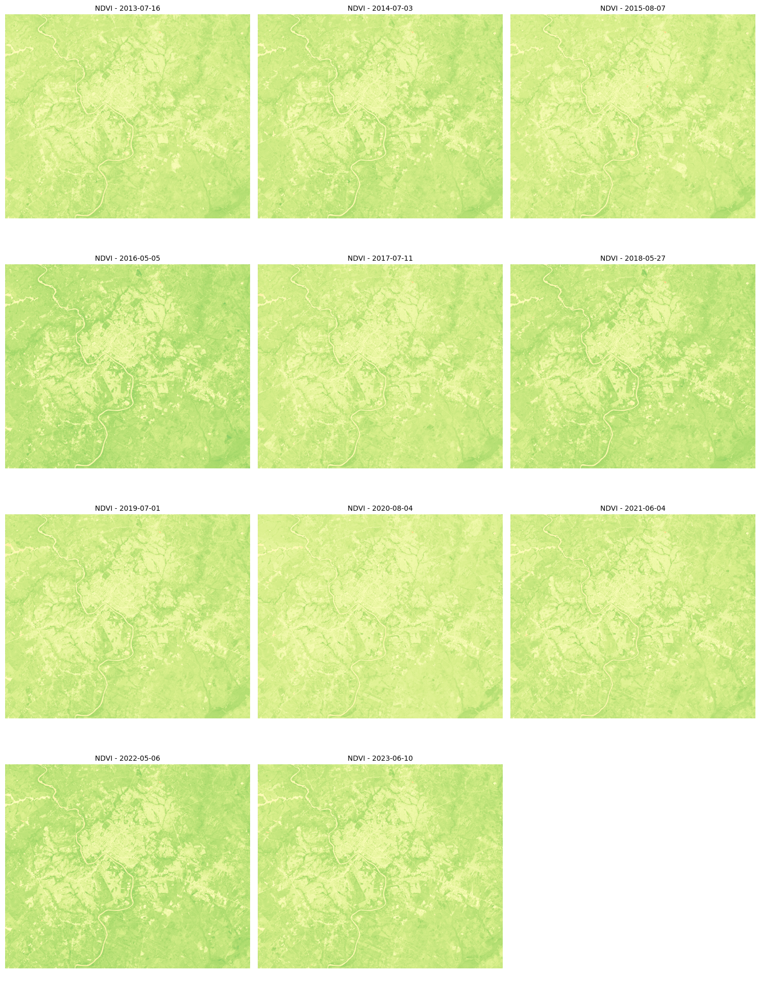

In [24]:
plotar_ndvi(imagens_processadas[:-1])

In [30]:
def plotar_indice(resultados, banda='NDVI', scale=30, vmin=-1, vmax=1, cmap='RdYlGn', ncols=3):
    """
    Plota qualquer índice (NDVI, EVI, NDBI, UI...) extraído da imagem_raw.

    Parâmetros:
    - resultados: lista de dicionários com 'imagem_raw' (ee.Image)
    - banda: nome da banda que será exibida
    - scale: resolução espacial em metros
    - vmin, vmax: intervalo de valores para a coloração
    - cmap: colormap matplotlib (ex: 'RdYlGn', 'viridis', 'gray')
    - ncols: número de colunas na grade de plots
    """
    import matplotlib.pyplot as plt
    import numpy as np

    n = len(resultados)
    nrows = (n + ncols - 1) // ncols
    fig, axes = plt.subplots(nrows, ncols, figsize=(5*ncols, 5*nrows))
    axes = axes.flatten()

    for i, r in enumerate(resultados):
        ax = axes[i]
        try:
            imagem = r['imagem_raw']
            banda_img = imagem.select(banda)
            arr = geemap.ee_to_numpy(banda_img, region=geometry, scale=scale).squeeze()

            if np.isnan(arr).all():
                ax.text(0.5, 0.5, "Índice vazio", ha='center', va='center')
            else:
                arr = np.clip(arr, vmin, vmax)
                ax.imshow(arr, cmap=cmap, vmin=vmin, vmax=vmax)
                ax.set_title(f"{banda} - {r['data']}", fontsize=10)

            ax.axis('off')

        except Exception as e:
            print(f"Erro ao plotar {banda} para imagem {i}: {e}")
            ax.text(0.5, 0.5, "Erro", ha='center', va='center')
            ax.axis('off')

    for j in range(i+1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()


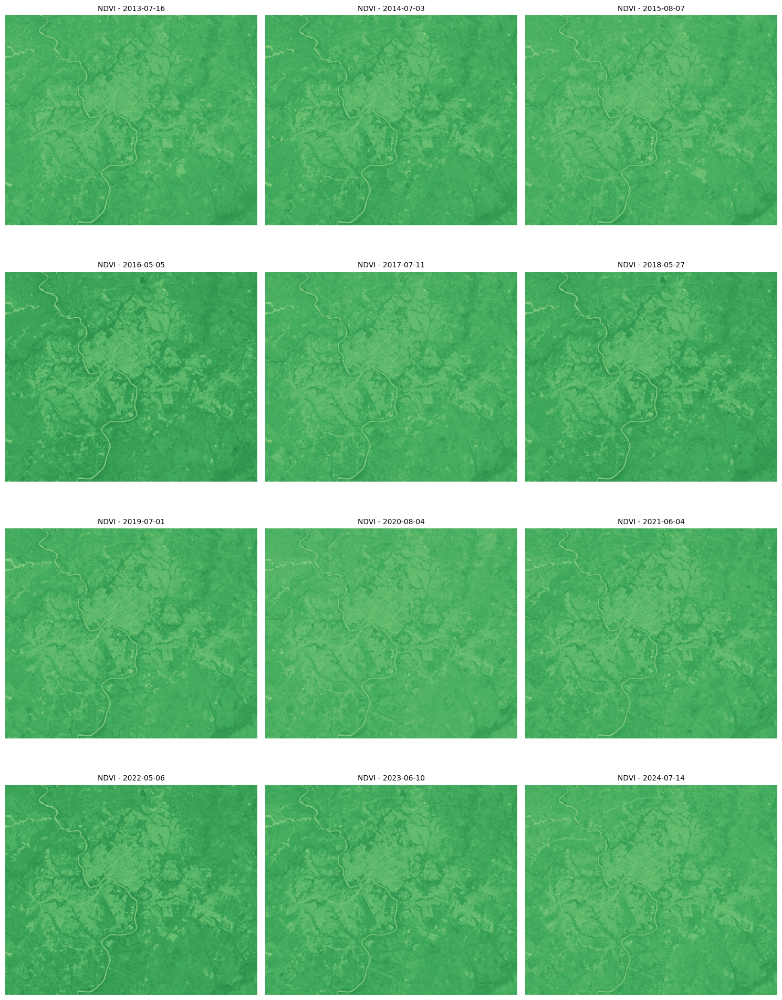

In [50]:
plotar_indice(imagens_processadas, banda='NDVI', vmin=-1, vmax=1, cmap='YlGn')

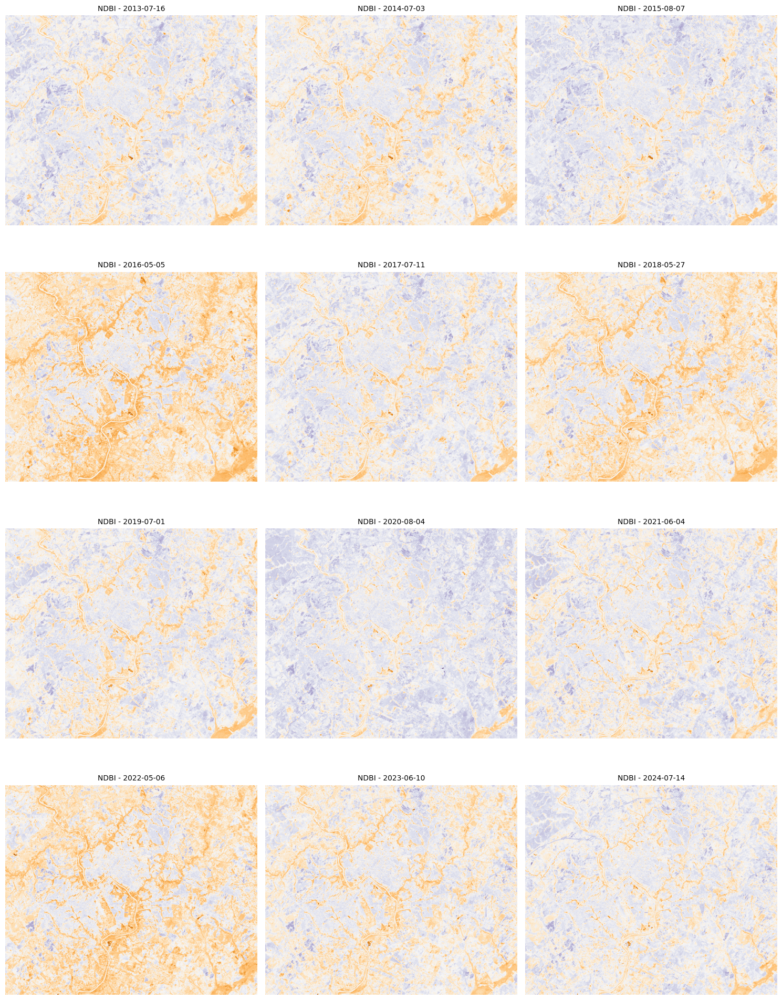

In [32]:
plotar_indice(imagens_processadas, banda='NDBI', vmin=-0.5, vmax=0.5, cmap='PuOr')

In [48]:
def contar_acima_da_media_desvio_ee(imagem, banda='NDVI', region=None, scale=30, desvios=1.0, valor=None):
    """
    Conta quantos pixels estão acima de (média + x * desvio padrão) para a banda escolhida.

    Parâmetros:
    - imagem: ee.Image (com a banda já adicionada, ex: 'NDVI')
    - banda: nome da banda a analisar
    - region: ee.Geometry da área de interesse
    - scale: resolução espacial (em metros)
    - desvios: número de desvios padrão acima da média

    Retorna:
    - media: valor médio
    - desvio: desvio padrão
    - limite: limiar calculado (media + x * desvio)
    - total: total de pixels válidos
    - acima: número de pixels acima do limiar
    - proporcao: fração de pixels acima
    """
    import numpy as np

    try:
        array = geemap.ee_to_numpy(imagem.select(banda), region=region, scale=scale).squeeze()
        array = array.ravel()
        array = array[~np.isnan(array)]  # Remove NaNs

        if len(array) == 0:
            return None, None, None, 0, 0, 0

        media = np.mean(array)
        desvio = np.std(array)
        limite = media + desvios * desvio
        if valor:
            limite = valor
    
        acima = np.sum(array > limite)
        total = len(array)
        proporcao = acima / total

        return media, desvio, limite, total, acima, proporcao

    except Exception as e:
        print(f"Erro ao calcular estatísticas de {banda}: {e}")
        return None, None, None, 0, 0, 0


In [49]:
a = []
for im in imagens_processadas:
    imagem = im['imagem_raw']  # Ex: imagem de 2020

    media, desvio, limiar, total, acima, prop = contar_acima_da_media_desvio_ee(
        imagem, banda='NDBI', region=geometry, scale=30, desvios=0.15, valor=0.0
)
    a.append(prop)
    print(prop)

# print(f"Média: {media:.4f}")
# print(f"Desvio padrão: {desvio:.4f}")
# print(f"Limiar (média + 1.5σ): {limiar:.4f}")
# print(f"Total de pixels válidos: {total}")
# print(f"Número acima do limiar: {acima}")
# print(f"Proporção acima: {prop:.2%}")

0.4677426951567636
0.45299494185955236
0.49348407706252906
0.41646033603340943
0.4805131837655579
0.43828043542305245
0.4737086596066342
0.4940123327382761
0.4762132564468895
0.4290378081452962
0.4604459327545301
0.48094816352653147
